<font size="5">Importing the Required Libraries.</font>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split


from xgboost import XGBClassifier
from catboost import CatBoostClassifier

import optuna
from optuna import visualization
from optuna.samplers import TPESampler

from sklearn.metrics import roc_curve, roc_auc_score, classification_report, accuracy_score, confusion_matrix, auc

import joblib

- If you have not intsalled 
- pip install optuna
- pip install xgboost
- pip install catboost

**Importing the training and label data**

In [2]:
training = pd.read_csv('training_set_features.csv')

In [3]:
training.head()

,respondent_id,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,...,income_poverty,marital_status,rent_or_own,employment_status,hhs_geo_region,census_msa,household_adults,household_children,employment_industry,employment_occupation
0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,Below Poverty,Not Married,Own,Not in Labor Force,oxchjgsf,Non-MSA,0.0,0.0,NaN,NaN
1,1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,...,Below Poverty,Not Married,Rent,Employed,bhuqouqj,"MSA, Not Principle City",0.0,0.0,pxcmvdjn,xgwztkwe
2,2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,"<= $75,000, Above Poverty",Not Married,Own,Employed,qufhixun,"MSA, Not Principle City",2.0,0.0,rucpziij,xtkaffoo
3,3,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,...,Below Poverty,Not Married,Rent,Not in Labor Force,lrircsnp,"MSA, Principle City",0.0,0.0,NaN,NaN
4,4,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,...,"<= $75,000, Above Poverty",Married,Own,Employed,qufhixun,"MSA, Not Principle City",1.0,0.0,wxleyezf,emcorrxb


In [4]:
label = pd.read_csv('training_set_labels.csv')

In [5]:
label.shape

(26707, 3)

In [6]:
training.columns

Index(['respondent_id', 'h1n1_concern', 'h1n1_knowledge',
       'behavioral_antiviral_meds', 'behavioral_avoidance',
       'behavioral_face_mask', 'behavioral_wash_hands',
       'behavioral_large_gatherings', 'behavioral_outside_home',
       'behavioral_touch_face', 'doctor_recc_h1n1', 'doctor_recc_seasonal',
       'chronic_med_condition', 'child_under_6_months', 'health_worker',
       'health_insurance', 'opinion_h1n1_vacc_effective', 'opinion_h1n1_risk',
       'opinion_h1n1_sick_from_vacc', 'opinion_seas_vacc_effective',
       'opinion_seas_risk', 'opinion_seas_sick_from_vacc', 'age_group',
       'education', 'race', 'sex', 'income_poverty', 'marital_status',
       'rent_or_own', 'employment_status', 'hhs_geo_region', 'census_msa',
       'household_adults', 'household_children', 'employment_industry',
       'employment_occupation'],
      dtype='object')

**- Heatmaps for Analysing Missing Value Patterns**

- From the Heatmap, we can clearly identify some <u>patterns</u> in missing value.

In [61]:
Missing_value_heatmap = px.imshow(training.isnull(), color_continuous_scale='Purples')

Missing_value_heatmap.show()

<font size="3">Checking Categorical Missing Data</font>

**- Checking Missing values for Employment Occupation and Industry Data for Unemployed respondents.** 

- People who are unemployed will have NaN value in employment industry and occupation. 

In [62]:
training[training["employment_status"]=="Unemployed"][["employment_industry",
                                                                     "employment_occupation"]].isna().sum()

employment_industry      1453
employment_occupation    1453
dtype: int64

**- Checking Missing values for Employment Occupation and Industry Data for 'Not in Labor Force'.** 
- People who are 'Not in Labor Force' will have NaN value in employment industry and occupation. 

In [63]:
training[training["employment_status"]=="Not in Labor Force"][["employment_industry",
                                                                     "employment_occupation"]].isna().sum()

employment_industry      10231
employment_occupation    10231
dtype: int64

**- Checking Missing values for Employment Occupation and Industry Data for 'Employed People'.**
- Some people who are Employed but still, they have NaN values in the employment industry and occupation.

In [64]:
training[training["employment_status"]=="Employed"][["employment_industry",
                                                           "employment_occupation"]].isna().sum()

employment_industry      183
employment_occupation    323
dtype: int64

<font size="5">Missing Value Imputation for Categorical Data</font> 



In [65]:
training[category_columns].isna().sum()

race                         0
sex                          0
marital_status            1408
rent_or_own               2042
hhs_geo_region               0
census_msa                   0
employment_industry      13330
employment_occupation    13470
dtype: int64

**- Imputing Missing Value for 'employment_occupation'**

- Assigning missing values for employment_occupation with appropiate imputaion corresponding to their employment status.

In [66]:
for i, row in training[training['employment_occupation'].isna()].iterrows():
    conditions = (training["employment_status"]=="Unemployed")
    if conditions.any():
        training.loc[i, 'employment_occupation'] = 'unemployed_occupation'

In [67]:
for i, row in training[training['employment_occupation'].isna()].iterrows():
    conditions = (training["employment_status"]=="Not in Labor Force")
    if conditions.any():
        training.loc[i, 'employment_occupation'] = 'Not_in_laborforce'

In [68]:
for i, row in training[training['employment_occupation'].isna()].iterrows():
    conditions = (training["employment_status"]=="Employed")
    if conditions.any():
        training.loc[i, 'employment_occupation'] = 'other_occupation'

**- Imputing Missing Value for 'employment_industry'**
- Assigning missing values for employment_industry with appropiate imputaion corresponding to their employment status.

In [69]:
for i, row in training[training['employment_industry'].isna()].iterrows():
    conditions = (training["employment_status"]=="Unemployed")
    if conditions.any():
        training.loc[i, 'employment_industry'] = 'unemployed_in_industry'

In [70]:
for i, row in training[training['employment_industry'].isna()].iterrows():
    conditions = (training["employment_status"]=="Not in Labor Force")
    if conditions.any():
        training.loc[i, 'employment_industry'] = 'Not_in_laborforce'

In [71]:
for i, row in training[training['employment_industry'].isna()].iterrows():
    conditions = (training["employment_status"]=="Employed")
    if conditions.any():
        training.loc[i, 'employment_industry'] = 'other_industry'

**- Imputing Missing Values for 'income_poverty', 'marital_status', 'employment_status', 'rent_or_own' and 'education'.**

    - Assigning missing values for the above columns with appropiate imputaion

In [72]:
income_poverty_nan = 'refused_or_unknown'
marital_status_nan = 'refused_or_other_category'
employment_status_nan = 'refused_or_other_category'
rent_or_own_nan = 'other_or_refused'
education_nan = 'refused_or_unknown'


training['income_poverty'].fillna(income_poverty_nan, inplace=True)
training['marital_status'].fillna(marital_status_nan, inplace=True)
training['employment_status'].fillna(employment_status_nan, inplace=True)
training['rent_or_own'].fillna(rent_or_own_nan, inplace=True)
training['education'].fillna(education_nan, inplace=True)

In [73]:
training[category_columns].isna().sum()

race                     0
sex                      0
marital_status           0
rent_or_own              0
hhs_geo_region           0
census_msa               0
employment_industry      0
employment_occupation    0
dtype: int64

**- Categories without Encoding for CatBoost**

In [74]:
training_minus_cat = training.copy()

<font size="5">Encoding Categorical Data</font> <u>
<br>

**- As we don't want to encode numeric data, we will be encoding Categorical data first and missing value imputation part will be done later.**

In [75]:
le = LabelEncoder()

- Encoding Ordinal Columns

In [76]:
for features in ordinal_columns:
    training[features] = le.fit_transform(training[features])

In [77]:
training[ordinal_columns].head()

,age_group,education,income_poverty,employment_status
0,3,1,2,1
1,1,0,2,0
2,0,2,0,0
3,4,0,2,1
4,2,3,0,0


- Encoding Category Columns

In [78]:
training = pd.get_dummies(training, columns=category_columns, drop_first=True)

In [79]:
training.head()

,respondent_id,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,...,employment_occupation_rcertsgn,employment_occupation_tfqavkke,employment_occupation_ukymxvdu,employment_occupation_unemployed_occupation,employment_occupation_uqqtjvyb,employment_occupation_vlluhbov,employment_occupation_xgwztkwe,employment_occupation_xqwwgdyp,employment_occupation_xtkaffoo,employment_occupation_xzmlyyjv
0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,0,0,0,1,0,0,0,0,0,0
1,1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,...,0,0,0,0,0,0,1,0,0,0
2,2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,1,0
3,3,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,...,0,0,0,1,0,0,0,0,0,0
4,4,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,...,0,0,0,0,0,0,0,0,0,0


<font size="5">Dealing Misssing Values in Numeric Data</font>
<br>



**- NaN and -1 imputation was done by**-Karthikeyan psxks12

In [80]:
training[numeric_columns].isna().sum()

respondent_id                      0
h1n1_concern                      92
h1n1_knowledge                   116
behavioral_antiviral_meds         71
behavioral_avoidance             208
behavioral_face_mask              19
behavioral_wash_hands             42
behavioral_large_gatherings       87
behavioral_outside_home           82
behavioral_touch_face            128
doctor_recc_h1n1                2160
doctor_recc_seasonal            2160
chronic_med_condition            971
child_under_6_months             820
health_worker                    804
health_insurance               12274
opinion_h1n1_vacc_effective      391
opinion_h1n1_risk                388
opinion_h1n1_sick_from_vacc      395
opinion_seas_vacc_effective      462
opinion_seas_risk                514
opinion_seas_sick_from_vacc      537
household_adults                 249
household_children               249
dtype: int64

- Creating New DataFrame for the appropiate imputation 
<br>

    - <b>training_minus</b> :"-1" is imputed for missing values.
    
    - <b>training_NaN</b> : This DataFrame has "NaN" for missing values.

In [81]:
training_minus = training.copy()
training_NaN = training.copy()

- Imputing missing values

In [82]:
training_minus.fillna(value = -1, inplace=True)
training_minus_cat.fillna(value = -1, inplace=True)

- Again Checking for Missing Value

In [83]:
training_minus.isna().sum()

respondent_id                     0
h1n1_concern                      0
h1n1_knowledge                    0
behavioral_antiviral_meds         0
behavioral_avoidance              0
                                 ..
employment_occupation_vlluhbov    0
employment_occupation_xgwztkwe    0
employment_occupation_xqwwgdyp    0
employment_occupation_xtkaffoo    0
employment_occupation_xzmlyyjv    0
Length: 91, dtype: int64

- Good to Go!

<font size="5">Prediction Using XGBoost</font>

In [143]:
combined_df = pd.merge(training_NaN, label, on='respondent_id')

- data will be the training features for XGB model and preparing train test split with 20% of testing data. The same test size and random seed will be used for both "H1N1" and "Seasonal" model.

In [144]:
data = combined_df.drop(['h1n1_vaccine', 'seasonal_vaccine', 'respondent_id'], axis=1)

In [145]:
X_train, X_test, y_train, y_test = train_test_split(data, y1, test_size=0.2, random_state=101)

**Preparing and Predicting "XGB model for H1N1" with Default Parameters**

In [146]:
XGB_h1 = XGBClassifier(missing=np.nan)

In [147]:
XGB_h1.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [148]:
XGB_predict_h1 = XGB_h1.predict(X_test)

**Evaluating "H1N1 model" <u>without hyperparameter tuning</u>**

In [149]:
print(classification_report(y_test, XGB_predict_h1))

              precision    recall  f1-score   support

           0       0.88      0.94      0.91      4199
           1       0.70      0.53      0.60      1143

    accuracy                           0.85      5342
   macro avg       0.79      0.73      0.75      5342
weighted avg       0.84      0.85      0.84      5342



In [150]:
h1_prediction_roc = XGB_h1.predict_proba(X_test)[:, 1]

roc_auc = roc_auc_score(y_test, h1_prediction_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8571238371340758


**Preparing and Predicting "XGB model for Seasonal" with Default Parameters**

In [151]:
X_train, X_test, y_train, y_test = train_test_split(data, y2, test_size=0.2, random_state=101)

In [152]:
XGB_seas = XGBClassifier(missing=np.nan)

In [153]:
XGB_seas.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [154]:
XGB_predict_seas = XGB_seas.predict(X_test)

**Evaluating "Seasonal model" <u>without hyperparameter tuning</u>**

In [155]:
print(classification_report(y_test, XGB_predict_seas))

              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2823
           1       0.77      0.75      0.76      2519

    accuracy                           0.78      5342
   macro avg       0.78      0.77      0.78      5342
weighted avg       0.78      0.78      0.78      5342



In [156]:
seas_prediction_roc = XGB_seas.predict_proba(X_test)[:, 1]

roc_auc = roc_auc_score(y_test, seas_prediction_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8547784974470326


**- Hyperparameter Tuning using OPTUNA** 

In [160]:
X_train, X_test, y_train, y_test = train_test_split(data, y1,
                                                    test_size=0.2, random_state=101)


def objective(trial):
    param = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'reg_alpha': trial.suggest_float('reg_alpha', 1e-8, 1.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-8, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 6),
        'gamma': trial.suggest_float('gamma',1e-8, 1.0),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 0.8),
        'subsample': trial.suggest_float('subsample', 0.3, 0.8),
    }
    
    xgb = XGBClassifier(**param, missing= np.nan)
    
    from sklearn.model_selection import cross_val_score
    scores = cross_val_score(xgb, data, y1, cv=5, scoring='roc_auc')
    AUC = np.mean(scores).max() 
    return AUC

In [161]:
study_h1 = optuna.create_study(direction='maximize', sampler=TPESampler())
study_h1.optimize(objective, n_trials=120, show_progress_bar=True)

[I 2023-05-19 16:42:43,493] A new study created in memory with name: no-name-ceb921f0-b307-44d3-97d2-1bea3de341ac
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/optuna/progress_bar.py:56: ExperimentalWarning:

Progress bar is experimental (supported from v1.2.0). The interface can change in the future.



  0%|          | 0/120 [00:00<?, ?it/s]

[I 2023-05-19 16:43:24,716] Trial 0 finished with value: 0.8719592694925554 and parameters: {'n_estimators': 377, 'max_depth': 7, 'reg_alpha': 0.5455606119596196, 'reg_lambda': 0.04339918736678362, 'min_child_weight': 3, 'gamma': 0.4992942837313527, 'learning_rate': 0.01620837857827828, 'colsample_bytree': 0.6819822545244996, 'subsample': 0.6097452596437924}. Best is trial 0 with value: 0.8719592694925554.
[I 2023-05-19 16:43:40,872] Trial 1 finished with value: 0.7949221345557566 and parameters: {'n_estimators': 176, 'max_depth': 9, 'reg_alpha': 0.1911433266609178, 'reg_lambda': 0.7623334864901535, 'min_child_weight': 4, 'gamma': 0.5286819430514262, 'learning_rate': 0.6799735069115982, 'colsample_bytree': 0.34923456904090006, 'subsample': 0.49201890416139193}. Best is trial 0 with value: 0.8719592694925554.
[I 2023-05-19 16:44:11,161] Trial 2 finished with value: 0.8348532059899982 and parameters: {'n_estimators': 291, 'max_depth': 9, 'reg_alpha': 0.9941390944287669, 'reg_lambda': 0.8

[I 2023-05-19 16:53:18,629] Trial 20 finished with value: 0.8520581174379203 and parameters: {'n_estimators': 427, 'max_depth': 5, 'reg_alpha': 0.9251602770511006, 'reg_lambda': 0.5897301699644042, 'min_child_weight': 1, 'gamma': 0.003973228280797048, 'learning_rate': 0.21580737509283157, 'colsample_bytree': 0.5367620651712688, 'subsample': 0.7589801484327063}. Best is trial 0 with value: 0.8719592694925554.
[I 2023-05-19 16:54:01,976] Trial 21 finished with value: 0.8719309201350995 and parameters: {'n_estimators': 348, 'max_depth': 8, 'reg_alpha': 0.8401834552272986, 'reg_lambda': 0.9950086841897761, 'min_child_weight': 4, 'gamma': 0.34579235210058845, 'learning_rate': 0.02191862633138599, 'colsample_bytree': 0.5807539718185984, 'subsample': 0.7158213857255021}. Best is trial 0 with value: 0.8719592694925554.
[I 2023-05-19 16:54:41,466] Trial 22 finished with value: 0.8598264551842035 and parameters: {'n_estimators': 385, 'max_depth': 8, 'reg_alpha': 0.736181148273599, 'reg_lambda': 

[I 2023-05-19 17:18:41,366] Trial 40 finished with value: 0.8479524606801565 and parameters: {'n_estimators': 500, 'max_depth': 9, 'reg_alpha': 0.9514426212093071, 'reg_lambda': 0.8991912178580831, 'min_child_weight': 6, 'gamma': 0.23869756082178928, 'learning_rate': 0.1353601322936834, 'colsample_bytree': 0.6027605952978864, 'subsample': 0.6479366254216156}. Best is trial 33 with value: 0.8720300976639415.
[I 2023-05-19 17:19:09,746] Trial 41 finished with value: 0.8722665559416869 and parameters: {'n_estimators': 358, 'max_depth': 6, 'reg_alpha': 0.9620099570891265, 'reg_lambda': 0.938779124556677, 'min_child_weight': 2, 'gamma': 0.12214478978507708, 'learning_rate': 0.023265451341429384, 'colsample_bytree': 0.576224716624057, 'subsample': 0.697153884357193}. Best is trial 41 with value: 0.8722665559416869.
[I 2023-05-19 17:19:30,739] Trial 42 finished with value: 0.8714854689271743 and parameters: {'n_estimators': 316, 'max_depth': 5, 'reg_alpha': 0.9070467015488828, 'reg_lambda': 0

[I 2023-05-19 17:29:14,733] Trial 60 finished with value: 0.8452129890773701 and parameters: {'n_estimators': 448, 'max_depth': 8, 'reg_alpha': 0.697314790872076, 'reg_lambda': 0.7504065035092367, 'min_child_weight': 4, 'gamma': 0.18283039941969229, 'learning_rate': 0.17762065098251012, 'colsample_bytree': 0.609695371112366, 'subsample': 0.6964175967869238}. Best is trial 41 with value: 0.8722665559416869.
[I 2023-05-19 17:29:39,337] Trial 61 finished with value: 0.8717819353649541 and parameters: {'n_estimators': 321, 'max_depth': 5, 'reg_alpha': 0.9041918018427761, 'reg_lambda': 0.9489492674470872, 'min_child_weight': 2, 'gamma': 0.0972070273100952, 'learning_rate': 0.04272812442311923, 'colsample_bytree': 0.5699571440333882, 'subsample': 0.7314437339121553}. Best is trial 41 with value: 0.8722665559416869.
[I 2023-05-19 17:29:54,501] Trial 62 finished with value: 0.8688927595626612 and parameters: {'n_estimators': 320, 'max_depth': 3, 'reg_alpha': 0.7621867350665424, 'reg_lambda': 0

[I 2023-05-19 17:39:09,505] Trial 80 finished with value: 0.8545535528809143 and parameters: {'n_estimators': 410, 'max_depth': 7, 'reg_alpha': 0.8731072527941915, 'reg_lambda': 0.8721672297170631, 'min_child_weight': 3, 'gamma': 0.13912113276413038, 'learning_rate': 0.12868957055575272, 'colsample_bytree': 0.5338074475886287, 'subsample': 0.761509702265571}. Best is trial 41 with value: 0.8722665559416869.
[I 2023-05-19 17:39:39,046] Trial 81 finished with value: 0.8721342291975518 and parameters: {'n_estimators': 365, 'max_depth': 5, 'reg_alpha': 0.975351919981007, 'reg_lambda': 0.9754800423081813, 'min_child_weight': 2, 'gamma': 0.09460044472803408, 'learning_rate': 0.03213855715655925, 'colsample_bytree': 0.5887913011213857, 'subsample': 0.6686254720733967}. Best is trial 41 with value: 0.8722665559416869.
[I 2023-05-19 17:40:06,017] Trial 82 finished with value: 0.8706228715200517 and parameters: {'n_estimators': 340, 'max_depth': 5, 'reg_alpha': 0.9735417149695501, 'reg_lambda': 

[I 2023-05-19 17:51:56,295] Trial 100 finished with value: 0.8717927029024457 and parameters: {'n_estimators': 434, 'max_depth': 7, 'reg_alpha': 0.9446183831816762, 'reg_lambda': 0.933197450545054, 'min_child_weight': 5, 'gamma': 0.32222596212533483, 'learning_rate': 0.026673434498090266, 'colsample_bytree': 0.6527780339391872, 'subsample': 0.6829165003086496}. Best is trial 91 with value: 0.872275572166038.
[I 2023-05-19 17:52:34,704] Trial 101 finished with value: 0.8696568028699465 and parameters: {'n_estimators': 347, 'max_depth': 6, 'reg_alpha': 0.9607448314507954, 'reg_lambda': 0.9730834210475224, 'min_child_weight': 5, 'gamma': 0.28116580391710755, 'learning_rate': 0.06022737266886058, 'colsample_bytree': 0.5805622901603348, 'subsample': 0.6985434543633996}. Best is trial 91 with value: 0.872275572166038.
[I 2023-05-19 17:53:18,840] Trial 102 finished with value: 0.8722160421586184 and parameters: {'n_estimators': 383, 'max_depth': 6, 'reg_alpha': 0.9256642653966181, 'reg_lambda

**- H1N1 Best params**

In [162]:
study_h1.best_trial       # Best trial with best parameters

FrozenTrial(number=91, state=TrialState.COMPLETE, values=[0.872275572166038], datetime_start=datetime.datetime(2023, 5, 19, 17, 44, 9, 370107), datetime_complete=datetime.datetime(2023, 5, 19, 17, 44, 45, 875303), params={'n_estimators': 357, 'max_depth': 6, 'reg_alpha': 0.9526373620859971, 'reg_lambda': 0.9172683413926652, 'min_child_weight': 2, 'gamma': 0.2081422299233378, 'learning_rate': 0.024063183390392665, 'colsample_bytree': 0.5774452981988635, 'subsample': 0.7173181656097279}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'n_estimators': IntDistribution(high=500, log=False, low=50, step=1), 'max_depth': IntDistribution(high=10, log=False, low=3, step=1), 'reg_alpha': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'reg_lambda': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'min_child_weight': IntDistribution(high=6, log=False, low=0, step=1), 'gamma': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'learning_

In [163]:
h1n1_param = study_h1.best_params

In [164]:
h1n1_param

{'n_estimators': 357,
 'max_depth': 6,
 'reg_alpha': 0.9526373620859971,
 'reg_lambda': 0.9172683413926652,
 'min_child_weight': 2,
 'gamma': 0.2081422299233378,
 'learning_rate': 0.024063183390392665,
 'colsample_bytree': 0.5774452981988635,
 'subsample': 0.7173181656097279}

In [165]:
study_h1.pruner

In [166]:
X_train, X_test, y_train, y_test = train_test_split(data, y2,
                                                    test_size=0.2, random_state=101)


def objective(trial):
    param = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'reg_alpha': trial.suggest_float('reg_alpha', 1e-8, 1.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-8, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 6),
        'gamma': trial.suggest_float('gamma',1e-8, 1.0),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 0.8),
        'subsample': trial.suggest_float('subsample', 0.3, 0.8),
    }
    
    xgb = XGBClassifier(**param, missing= np.nan)
    
    from sklearn.model_selection import cross_val_score
    scores = cross_val_score(xgb, data, y2, cv=5, scoring='roc_auc')
    AUC = np.mean(scores).max() 
    return AUC

In [167]:
study_seas = optuna.create_study(direction='maximize', sampler=TPESampler())
study_seas.optimize(objective, n_trials=120, show_progress_bar=True)

[I 2023-05-19 18:16:56,541] A new study created in memory with name: no-name-a6ef69a3-79e2-4401-a9d4-6d70ff8c04cf
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/optuna/progress_bar.py:56: ExperimentalWarning:

Progress bar is experimental (supported from v1.2.0). The interface can change in the future.



  0%|          | 0/120 [00:00<?, ?it/s]

[I 2023-05-19 18:17:56,211] Trial 0 finished with value: 0.863423610226878 and parameters: {'n_estimators': 362, 'max_depth': 10, 'reg_alpha': 0.32763892173394854, 'reg_lambda': 0.9634616521463987, 'min_child_weight': 0, 'gamma': 0.8361322079184171, 'learning_rate': 0.014784623626949147, 'colsample_bytree': 0.5056460788233242, 'subsample': 0.7204181374620316}. Best is trial 0 with value: 0.863423610226878.
[I 2023-05-19 18:18:26,279] Trial 1 finished with value: 0.80469672054001 and parameters: {'n_estimators': 335, 'max_depth': 5, 'reg_alpha': 0.12196934151449897, 'reg_lambda': 0.9956366206034424, 'min_child_weight': 4, 'gamma': 0.9934180891396005, 'learning_rate': 0.6784787829573024, 'colsample_bytree': 0.7178251638397655, 'subsample': 0.5571743685057908}. Best is trial 0 with value: 0.863423610226878.
[I 2023-05-19 18:19:23,384] Trial 2 finished with value: 0.8570339558741191 and parameters: {'n_estimators': 451, 'max_depth': 7, 'reg_alpha': 0.9203761946378539, 'reg_lambda': 0.78460

[I 2023-05-19 18:26:08,916] Trial 20 finished with value: 0.8604641933115385 and parameters: {'n_estimators': 217, 'max_depth': 4, 'reg_alpha': 0.843002404635652, 'reg_lambda': 0.39550362812976764, 'min_child_weight': 3, 'gamma': 0.7508120418694905, 'learning_rate': 0.21657259393985823, 'colsample_bytree': 0.5670710628854769, 'subsample': 0.671981222150495}. Best is trial 0 with value: 0.863423610226878.
[I 2023-05-19 18:26:29,096] Trial 21 finished with value: 0.8631565133321514 and parameters: {'n_estimators': 388, 'max_depth': 4, 'reg_alpha': 0.018743069183476013, 'reg_lambda': 0.5828930959324056, 'min_child_weight': 1, 'gamma': 0.8076024931878286, 'learning_rate': 0.09938429514926114, 'colsample_bytree': 0.39729991495897937, 'subsample': 0.5959111151872142}. Best is trial 0 with value: 0.863423610226878.
[I 2023-05-19 18:26:45,185] Trial 22 finished with value: 0.8619798970710196 and parameters: {'n_estimators': 370, 'max_depth': 3, 'reg_alpha': 0.25659209150251183, 'reg_lambda': 0

[I 2023-05-19 18:30:40,416] Trial 40 finished with value: 0.8637907759227634 and parameters: {'n_estimators': 146, 'max_depth': 5, 'reg_alpha': 0.3829731513845096, 'reg_lambda': 0.7119415105259081, 'min_child_weight': 4, 'gamma': 0.4347575093835331, 'learning_rate': 0.12534959059698172, 'colsample_bytree': 0.3659871978675796, 'subsample': 0.6317036422824684}. Best is trial 34 with value: 0.8652431705960787.
[I 2023-05-19 18:30:55,141] Trial 41 finished with value: 0.8654959253497531 and parameters: {'n_estimators': 234, 'max_depth': 5, 'reg_alpha': 0.3070805272769032, 'reg_lambda': 0.7945740844263325, 'min_child_weight': 2, 'gamma': 0.5296282569560926, 'learning_rate': 0.05435061605941162, 'colsample_bytree': 0.36969412717104505, 'subsample': 0.6662892275261773}. Best is trial 41 with value: 0.8654959253497531.
[I 2023-05-19 18:31:06,947] Trial 42 finished with value: 0.8649911055214409 and parameters: {'n_estimators': 231, 'max_depth': 4, 'reg_alpha': 0.18463824569014714, 'reg_lambda'

[I 2023-05-19 18:37:36,246] Trial 60 finished with value: 0.8649404533532999 and parameters: {'n_estimators': 262, 'max_depth': 6, 'reg_alpha': 0.5358904575459917, 'reg_lambda': 0.6517112233956865, 'min_child_weight': 3, 'gamma': 0.291472196778791, 'learning_rate': 0.05062147076467683, 'colsample_bytree': 0.35043691504505187, 'subsample': 0.778398100934987}. Best is trial 41 with value: 0.8654959253497531.
[I 2023-05-19 18:37:57,452] Trial 61 finished with value: 0.8652863727946167 and parameters: {'n_estimators': 280, 'max_depth': 5, 'reg_alpha': 0.5600212776113521, 'reg_lambda': 0.7428777279603889, 'min_child_weight': 3, 'gamma': 0.24942732734768014, 'learning_rate': 0.053436750680334134, 'colsample_bytree': 0.4404427330565799, 'subsample': 0.7178030143443225}. Best is trial 41 with value: 0.8654959253497531.
[I 2023-05-19 18:38:20,333] Trial 62 finished with value: 0.8659020712942093 and parameters: {'n_estimators': 317, 'max_depth': 5, 'reg_alpha': 0.47980688152887074, 'reg_lambda'

[I 2023-05-19 18:46:43,296] Trial 80 finished with value: 0.8658288170570637 and parameters: {'n_estimators': 416, 'max_depth': 5, 'reg_alpha': 0.6428272015969981, 'reg_lambda': 0.522596242557198, 'min_child_weight': 6, 'gamma': 0.2190521857301454, 'learning_rate': 0.03190831966440047, 'colsample_bytree': 0.5192990592288731, 'subsample': 0.7125718313683423}. Best is trial 63 with value: 0.8660736685459369.
[I 2023-05-19 18:47:21,784] Trial 81 finished with value: 0.8656619669693789 and parameters: {'n_estimators': 484, 'max_depth': 5, 'reg_alpha': 0.6411263660513805, 'reg_lambda': 0.533760940264756, 'min_child_weight': 6, 'gamma': 0.2581191093067554, 'learning_rate': 0.030017546114559042, 'colsample_bytree': 0.5177455081549304, 'subsample': 0.7139056060946157}. Best is trial 63 with value: 0.8660736685459369.
[I 2023-05-19 18:48:00,519] Trial 82 finished with value: 0.8658030269891516 and parameters: {'n_estimators': 474, 'max_depth': 5, 'reg_alpha': 0.6341848956205531, 'reg_lambda': 0

[I 2023-05-19 18:58:40,427] Trial 100 finished with value: 0.8584692359469898 and parameters: {'n_estimators': 368, 'max_depth': 10, 'reg_alpha': 0.6696974035854214, 'reg_lambda': 0.5807308359329247, 'min_child_weight': 6, 'gamma': 0.1681932332748427, 'learning_rate': 0.06253895193248198, 'colsample_bytree': 0.5016850307810297, 'subsample': 0.7311956901277072}. Best is trial 63 with value: 0.8660736685459369.
[I 2023-05-19 18:59:17,325] Trial 101 finished with value: 0.8658377342822995 and parameters: {'n_estimators': 437, 'max_depth': 5, 'reg_alpha': 0.6347422115967046, 'reg_lambda': 0.554255180438984, 'min_child_weight': 6, 'gamma': 0.20511803559051242, 'learning_rate': 0.0394816189815174, 'colsample_bytree': 0.5304076601328254, 'subsample': 0.7104487199531079}. Best is trial 63 with value: 0.8660736685459369.
[I 2023-05-19 18:59:52,854] Trial 102 finished with value: 0.8657383430453944 and parameters: {'n_estimators': 439, 'max_depth': 5, 'reg_alpha': 0.6153599673728549, 'reg_lambda

In [168]:
study_seas.best_trial

FrozenTrial(number=63, state=TrialState.COMPLETE, values=[0.8660736685459369], datetime_start=datetime.datetime(2023, 5, 19, 18, 38, 20, 337325), datetime_complete=datetime.datetime(2023, 5, 19, 18, 38, 46, 83662), params={'n_estimators': 355, 'max_depth': 5, 'reg_alpha': 0.6025177173837138, 'reg_lambda': 0.7255655611590764, 'min_child_weight': 4, 'gamma': 0.23803836087384878, 'learning_rate': 0.044407830564428985, 'colsample_bytree': 0.4177399881065694, 'subsample': 0.7069118489410389}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'n_estimators': IntDistribution(high=500, log=False, low=50, step=1), 'max_depth': IntDistribution(high=10, log=False, low=3, step=1), 'reg_alpha': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'reg_lambda': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'min_child_weight': IntDistribution(high=6, log=False, low=0, step=1), 'gamma': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'learnin

In [169]:
param_seasonal = study_seas.best_params

In [170]:
param_seasonal

{'n_estimators': 355,
 'max_depth': 5,
 'reg_alpha': 0.6025177173837138,
 'reg_lambda': 0.7255655611590764,
 'min_child_weight': 4,
 'gamma': 0.23803836087384878,
 'learning_rate': 0.044407830564428985,
 'colsample_bytree': 0.4177399881065694,
 'subsample': 0.7069118489410389}

In [171]:
study_seas.pruner

**- Preparing the "H1N1 model" for predicting using the best parameters.**

In [261]:
X_train_h1, X_test_h1, y_train_h1, y_test_h1 = train_test_split(data, y1,
                                                                test_size=0.2, random_state=101)

In [262]:
h1n1_model_tuned = XGBClassifier(**h1n1_param, missing = np.nan)

In [263]:
h1n1_model_tuned.fit(X_train_h1, y_train_h1)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.5774452981988635, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.2081422299233378, gpu_id=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.024063183390392665, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=6, max_leaves=None,
              min_child_weight=2, missing=nan, monotone_constraints=None,
              n_estimators=357, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [264]:
h1n1_predict_tuned = h1n1_model_tuned.predict(X_test_h1)

**- Evaluating the H1N1 model**

In [265]:
print(classification_report(y_test_h1, h1n1_predict_tuned))

              precision    recall  f1-score   support

           0       0.88      0.95      0.91      4199
           1       0.75      0.51      0.60      1143

    accuracy                           0.86      5342
   macro avg       0.81      0.73      0.76      5342
weighted avg       0.85      0.86      0.85      5342



In [266]:
h1_tuned_roc = h1n1_model_tuned.predict_proba(X_test_h1)[:, 1]

roc_auc = roc_auc_score(y_test_h1, h1_tuned_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8677521227922242


**- Preparing the "Seasonal Model" for predicting using the best parameters.**

In [252]:
X_train_seas, X_test_seas, y_train_seas, y_test_seas = train_test_split(data, y2, 
                                                                        test_size=0.2, random_state=101)

In [253]:
seasonal_model_tuned = XGBClassifier(**param_seasonal, missing= np.nan)

In [254]:
seasonal_model_tuned.fit(X_train_seas, y_train_seas)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.4177399881065694, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.23803836087384878, gpu_id=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.044407830564428985, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=4, missing=nan, monotone_constraints=None,
              n_estimators=355, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [255]:
seas_predict_tuned = seasonal_model_tuned.predict(X_test_seas)

**- Evaluating the "Seasonal model".**

In [256]:
print(classification_report(y_test_seas, seas_predict_tuned))

              precision    recall  f1-score   support

           0       0.79      0.82      0.80      2823
           1       0.79      0.75      0.77      2519

    accuracy                           0.79      5342
   macro avg       0.79      0.79      0.79      5342
weighted avg       0.79      0.79      0.79      5342



In [257]:
seas_tuned_roc = seasonal_model_tuned.predict_proba(X_test_seas)[:, 1]

roc_auc = roc_auc_score(y_test_seas, seas_tuned_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8668577190961164


**- Plotting ROC Curve for H1N1 Vaccine.**

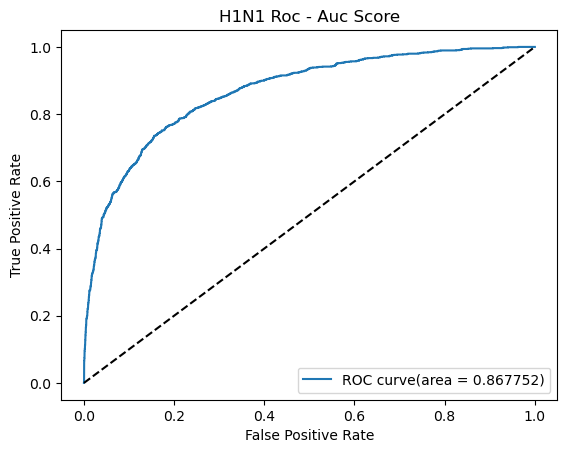

In [267]:
fpr, tpr, thresholds = roc_curve(y_test_h1, h1_tuned_roc)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('H1N1 Roc - Auc Score')
plt.legend(loc="lower right")
plt.show()

**- Plotting ROC Curve for Seasonal Vaccine.**

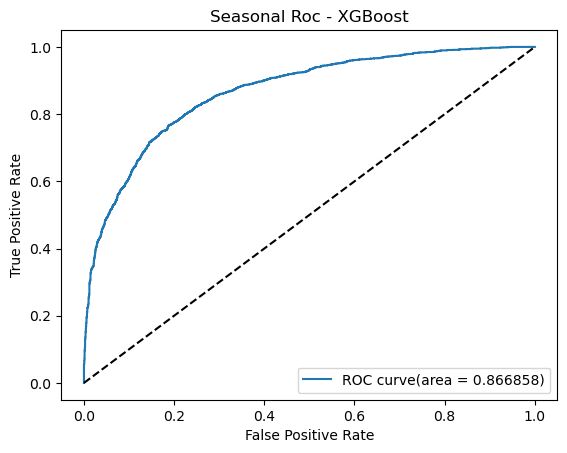

In [277]:
fpr, tpr, thresholds = roc_curve(y_test_seas, seas_tuned_roc)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Seasonal Roc - XGBoost')
plt.legend(loc="lower right")
plt.show()

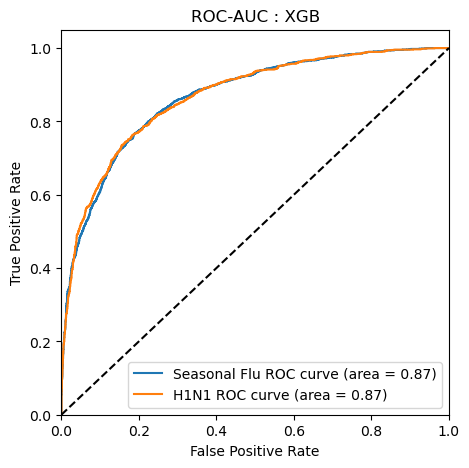

In [186]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt



models_dict = {"Seasonal Flu": (y_test_seas, seas_tuned_roc), "H1N1": (y_test_h1, h1_tuned_roc)} 
plt.figure(figsize=(5, 5))

for model_name, (y_test, y_score) in models_dict.items():
    fpr, tpr, _ = roc_curve(y_test, y_score)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label='{} ROC curve (area = {:.2f})'.format(model_name, roc_auc))


plt.plot([0, 1], [0, 1], 'k--')


plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC-AUC : XGB')
plt.legend(loc="lower right")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])


plt.show()

**- Checking the Feature Importance from XGB model for H1N1 vaccination.**

In [187]:
importance_scores_h1 = h1n1_model_tuned.get_booster().get_score(importance_type='weight')

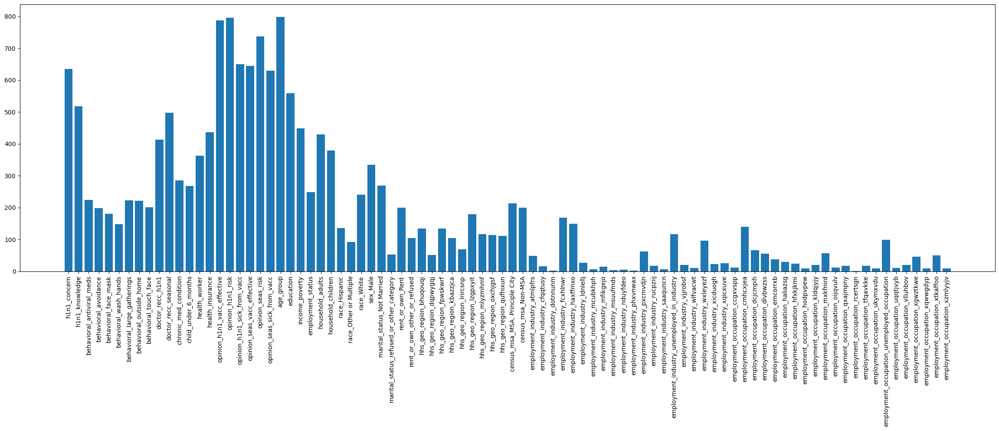

In [188]:
plt.figure(figsize=(29,8))
plt.bar(range(len(importance_scores_h1)), list(importance_scores_h1.values()),
        tick_label=list(importance_scores_h1.keys()))
plt.xticks(rotation=90)
plt.show()

**- Checking the Feature Importance from XGB model for Seasonal vaccination.**

In [189]:
importance_scores_seas = seasonal_model_tuned.get_booster().get_score(importance_type='weight')

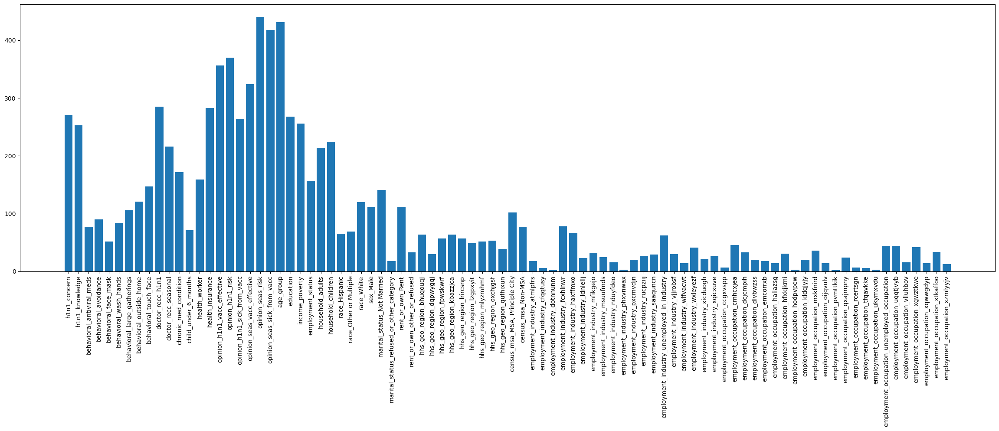

In [190]:
plt.figure(figsize=(29,8))
plt.bar(range(len(importance_scores_seas)), list(importance_scores_seas.values()),
        tick_label=list(importance_scores_seas.keys()))
plt.xticks(rotation=90)
plt.show()

<font size="5"> Predicting Probablility using CatBoost</font> 

- Since CatBoost takes more time to work, we used joblib and we are extracting information from the joblib.


    IMPORTANT Place the Joblib file and jupyter notebook should be in same directory.

In [191]:
import joblib

In [192]:
catBoost = joblib.load('H1_catBoost.joblib')

In [193]:
h1 = catBoost.get_params()

**- Importing best parameters from the trained model using joblib**

In [194]:
h1_params = {'iterations': 800,
 'learning_rate': 0.01763701383127006,
 'l2_leaf_reg': 17.4357146267731,
 'auto_class_weights': 'SqrtBalanced',
 'one_hot_max_size': 12,
 'random_strength': 5,
 'bagging_temperature': 1,
 'max_depth': 6,
 'max_bin': 10,
 'grow_policy': 'Depthwise',
 'min_data_in_leaf': 10}

**- Preparing CatBoost without encoding for H1N1**

In [195]:
X_train_h1, X_test_h1, y_train_h1, y_test_h1 = train_test_split( training_minus_cat,
                                                    y1, test_size=0.2, random_state=101)

In [196]:
categorical_features = np.where(X_train_h1.dtypes != float)[0]

In [197]:
from catboost import CatBoostClassifier

In [198]:
h1_cat_model = CatBoostClassifier(**h1_params, cat_features= categorical_features)

In [199]:
h1_cat_model.fit(X_train_h1, y_train_h1)

0:	learn: 0.6867346	total: 80.6ms	remaining: 1m 4s
1:	learn: 0.6798440	total: 95ms	remaining: 37.9s
2:	learn: 0.6735085	total: 110ms	remaining: 29.1s
3:	learn: 0.6677781	total: 127ms	remaining: 25.3s
4:	learn: 0.6623219	total: 140ms	remaining: 22.3s
5:	learn: 0.6562700	total: 157ms	remaining: 20.8s
6:	learn: 0.6499714	total: 172ms	remaining: 19.4s
7:	learn: 0.6451306	total: 186ms	remaining: 18.4s
8:	learn: 0.6391739	total: 201ms	remaining: 17.6s
9:	learn: 0.6335811	total: 215ms	remaining: 17s
10:	learn: 0.6297299	total: 230ms	remaining: 16.5s
11:	learn: 0.6254197	total: 244ms	remaining: 16s
12:	learn: 0.6202522	total: 258ms	remaining: 15.6s
13:	learn: 0.6160956	total: 274ms	remaining: 15.4s
14:	learn: 0.6123456	total: 290ms	remaining: 15.2s
15:	learn: 0.6078965	total: 306ms	remaining: 15s
16:	learn: 0.6035815	total: 321ms	remaining: 14.8s
17:	learn: 0.5999348	total: 335ms	remaining: 14.6s
18:	learn: 0.5965491	total: 348ms	remaining: 14.3s
19:	learn: 0.5924425	total: 362ms	remaining: 14

170:	learn: 0.4421287	total: 2.56s	remaining: 9.42s
171:	learn: 0.4419435	total: 2.58s	remaining: 9.4s
172:	learn: 0.4417056	total: 2.59s	remaining: 9.38s
173:	learn: 0.4414832	total: 2.6s	remaining: 9.37s
174:	learn: 0.4411941	total: 2.62s	remaining: 9.36s
175:	learn: 0.4410121	total: 2.63s	remaining: 9.34s
176:	learn: 0.4407319	total: 2.65s	remaining: 9.32s
177:	learn: 0.4404718	total: 2.66s	remaining: 9.31s
178:	learn: 0.4401751	total: 2.67s	remaining: 9.28s
179:	learn: 0.4399781	total: 2.69s	remaining: 9.26s
180:	learn: 0.4397670	total: 2.7s	remaining: 9.25s
181:	learn: 0.4395516	total: 2.72s	remaining: 9.23s
182:	learn: 0.4393129	total: 2.73s	remaining: 9.22s
183:	learn: 0.4391279	total: 2.75s	remaining: 9.2s
184:	learn: 0.4388894	total: 2.76s	remaining: 9.18s
185:	learn: 0.4387953	total: 2.78s	remaining: 9.18s
186:	learn: 0.4385804	total: 2.79s	remaining: 9.16s
187:	learn: 0.4384703	total: 2.81s	remaining: 9.14s
188:	learn: 0.4383020	total: 2.82s	remaining: 9.12s
189:	learn: 0.43

335:	learn: 0.4205233	total: 4.84s	remaining: 6.68s
336:	learn: 0.4204747	total: 4.85s	remaining: 6.67s
337:	learn: 0.4203950	total: 4.86s	remaining: 6.65s
338:	learn: 0.4203396	total: 4.88s	remaining: 6.63s
339:	learn: 0.4202482	total: 4.89s	remaining: 6.62s
340:	learn: 0.4201333	total: 4.91s	remaining: 6.61s
341:	learn: 0.4200643	total: 4.92s	remaining: 6.59s
342:	learn: 0.4200141	total: 4.93s	remaining: 6.57s
343:	learn: 0.4199064	total: 4.95s	remaining: 6.56s
344:	learn: 0.4198597	total: 4.96s	remaining: 6.54s
345:	learn: 0.4198048	total: 4.97s	remaining: 6.53s
346:	learn: 0.4196970	total: 4.99s	remaining: 6.51s
347:	learn: 0.4196024	total: 5s	remaining: 6.5s
348:	learn: 0.4195643	total: 5.02s	remaining: 6.48s
349:	learn: 0.4194833	total: 5.03s	remaining: 6.47s
350:	learn: 0.4194214	total: 5.04s	remaining: 6.45s
351:	learn: 0.4193317	total: 5.06s	remaining: 6.44s
352:	learn: 0.4192667	total: 5.07s	remaining: 6.42s
353:	learn: 0.4191629	total: 5.08s	remaining: 6.4s
354:	learn: 0.419

497:	learn: 0.4103630	total: 6.9s	remaining: 4.18s
498:	learn: 0.4103021	total: 6.92s	remaining: 4.17s
499:	learn: 0.4102186	total: 6.93s	remaining: 4.16s
500:	learn: 0.4101752	total: 6.95s	remaining: 4.14s
501:	learn: 0.4101478	total: 6.96s	remaining: 4.13s
502:	learn: 0.4100422	total: 6.97s	remaining: 4.12s
503:	learn: 0.4099856	total: 6.99s	remaining: 4.1s
504:	learn: 0.4099222	total: 7s	remaining: 4.09s
505:	learn: 0.4099024	total: 7.02s	remaining: 4.08s
506:	learn: 0.4098271	total: 7.04s	remaining: 4.07s
507:	learn: 0.4097727	total: 7.05s	remaining: 4.05s
508:	learn: 0.4097295	total: 7.07s	remaining: 4.04s
509:	learn: 0.4096507	total: 7.09s	remaining: 4.03s
510:	learn: 0.4095623	total: 7.1s	remaining: 4.02s
511:	learn: 0.4095110	total: 7.12s	remaining: 4.01s
512:	learn: 0.4094584	total: 7.14s	remaining: 3.99s
513:	learn: 0.4094124	total: 7.15s	remaining: 3.98s
514:	learn: 0.4093454	total: 7.16s	remaining: 3.96s
515:	learn: 0.4093158	total: 7.18s	remaining: 3.95s
516:	learn: 0.4092

664:	learn: 0.3972452	total: 9.16s	remaining: 1.86s
665:	learn: 0.3971897	total: 9.17s	remaining: 1.84s
666:	learn: 0.3970789	total: 9.19s	remaining: 1.83s
667:	learn: 0.3969928	total: 9.2s	remaining: 1.82s
668:	learn: 0.3968557	total: 9.21s	remaining: 1.8s
669:	learn: 0.3966971	total: 9.22s	remaining: 1.79s
670:	learn: 0.3966121	total: 9.24s	remaining: 1.78s
671:	learn: 0.3964823	total: 9.25s	remaining: 1.76s
672:	learn: 0.3963595	total: 9.26s	remaining: 1.75s
673:	learn: 0.3961950	total: 9.28s	remaining: 1.73s
674:	learn: 0.3960277	total: 9.29s	remaining: 1.72s
675:	learn: 0.3958822	total: 9.3s	remaining: 1.71s
676:	learn: 0.3957588	total: 9.31s	remaining: 1.69s
677:	learn: 0.3955943	total: 9.33s	remaining: 1.68s
678:	learn: 0.3954635	total: 9.34s	remaining: 1.66s
679:	learn: 0.3953561	total: 9.35s	remaining: 1.65s
680:	learn: 0.3951449	total: 9.37s	remaining: 1.64s
681:	learn: 0.3949766	total: 9.38s	remaining: 1.62s
682:	learn: 0.3948152	total: 9.4s	remaining: 1.61s
683:	learn: 0.39

**- CatBoost Prediction and Evaluation for H1N1**

In [200]:
h1_cat_predict = h1_cat_model.predict(X_test_h1)

In [201]:
print(classification_report(y_test_h1, h1_cat_predict))

              precision    recall  f1-score   support

           0       0.90      0.90      0.90      4199
           1       0.63      0.62      0.63      1143

    accuracy                           0.84      5342
   macro avg       0.77      0.76      0.76      5342
weighted avg       0.84      0.84      0.84      5342



In [202]:
cat_model_roc = h1_cat_model.predict_proba(X_test_h1)[:, 1]

roc_auc = roc_auc_score(y_test_h1, cat_model_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8681282070034173


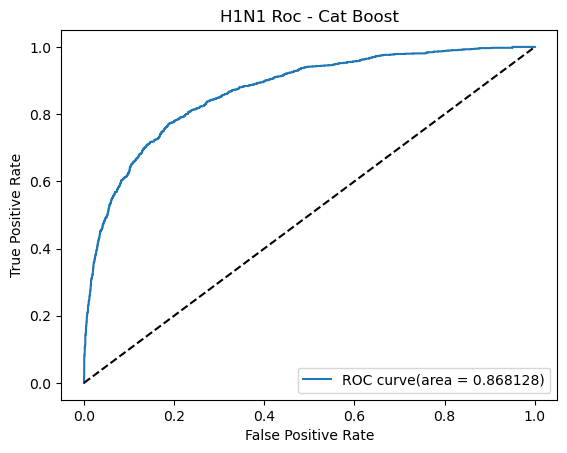

In [270]:
fpr, tpr, thresholds = roc_curve(y_test_h1, cat_model_roc)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('H1N1 Roc - Cat Boost')
plt.legend(loc="lower right")
plt.show()

**- Importing best parameters from the trained model using joblib**

In [203]:
seas_catBoost = joblib.load('Seas_catBoost.joblib')

In [204]:
seas = seas_catBoost.get_params()

In [205]:
seas

{'iterations': 550,
 'learning_rate': 0.06926791313818945,
 'l2_leaf_reg': 1.173150972058299,
 'auto_class_weights': 'Balanced',
 'one_hot_max_size': 500,
 'random_strength': 1,
 'bagging_temperature': 1,
 'max_depth': 4,
 'max_bin': 30,
 'cat_features': array([ 0, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 34, 35]),
 'grow_policy': 'Depthwise',
 'min_data_in_leaf': 5}

In [206]:
seas_params = {'iterations': 550,
 'learning_rate': 0.06926791313818945,
 'l2_leaf_reg': 1.173150972058299,
 'auto_class_weights': 'Balanced',
 'one_hot_max_size': 500,
 'random_strength': 1,
 'bagging_temperature': 1,
 'max_depth': 4,
 'max_bin': 30,
 'grow_policy': 'Depthwise',
 'min_data_in_leaf': 5}

**- Preparing CatBoost without encoding for Seasonal Flu**

In [207]:
X_train_seas, X_test_seas, y_train_seas, y_test_seas = train_test_split(training_minus_cat,
                                                    y2, test_size=0.2, random_state=101)

In [208]:
categorical_features = np.where(X_train_seas.dtypes != float)[0]

In [209]:
seas_cat_model = CatBoostClassifier(**seas_params, cat_features= categorical_features)

In [210]:
seas_cat_model.fit(X_train_seas, y_train_seas)

0:	learn: 0.6702299	total: 11.3ms	remaining: 6.21s
1:	learn: 0.6508964	total: 20.5ms	remaining: 5.61s
2:	learn: 0.6339686	total: 30.2ms	remaining: 5.51s
3:	learn: 0.6175778	total: 40ms	remaining: 5.46s
4:	learn: 0.6058941	total: 47.8ms	remaining: 5.21s
5:	learn: 0.5940838	total: 58.6ms	remaining: 5.31s
6:	learn: 0.5838184	total: 67.8ms	remaining: 5.25s
7:	learn: 0.5745303	total: 78.4ms	remaining: 5.31s
8:	learn: 0.5665310	total: 89.7ms	remaining: 5.39s
9:	learn: 0.5592085	total: 99.4ms	remaining: 5.37s
10:	learn: 0.5534023	total: 109ms	remaining: 5.32s
11:	learn: 0.5482994	total: 122ms	remaining: 5.46s
12:	learn: 0.5425638	total: 132ms	remaining: 5.44s
13:	learn: 0.5376782	total: 141ms	remaining: 5.4s
14:	learn: 0.5336651	total: 151ms	remaining: 5.37s
15:	learn: 0.5298810	total: 159ms	remaining: 5.32s
16:	learn: 0.5260255	total: 168ms	remaining: 5.26s
17:	learn: 0.5231888	total: 177ms	remaining: 5.24s
18:	learn: 0.5196638	total: 186ms	remaining: 5.21s
19:	learn: 0.5165015	total: 195ms	

169:	learn: 0.4430065	total: 1.66s	remaining: 3.7s
170:	learn: 0.4427163	total: 1.67s	remaining: 3.69s
171:	learn: 0.4425080	total: 1.68s	remaining: 3.68s
172:	learn: 0.4423714	total: 1.68s	remaining: 3.67s
173:	learn: 0.4422448	total: 1.69s	remaining: 3.66s
174:	learn: 0.4419974	total: 1.7s	remaining: 3.65s
175:	learn: 0.4418626	total: 1.71s	remaining: 3.64s
176:	learn: 0.4416533	total: 1.72s	remaining: 3.63s
177:	learn: 0.4414197	total: 1.73s	remaining: 3.62s
178:	learn: 0.4412686	total: 1.74s	remaining: 3.6s
179:	learn: 0.4411046	total: 1.75s	remaining: 3.6s
180:	learn: 0.4408119	total: 1.76s	remaining: 3.58s
181:	learn: 0.4405537	total: 1.77s	remaining: 3.57s
182:	learn: 0.4403170	total: 1.78s	remaining: 3.56s
183:	learn: 0.4401366	total: 1.78s	remaining: 3.55s
184:	learn: 0.4399538	total: 1.79s	remaining: 3.54s
185:	learn: 0.4396764	total: 1.8s	remaining: 3.53s
186:	learn: 0.4394504	total: 1.81s	remaining: 3.52s
187:	learn: 0.4392765	total: 1.82s	remaining: 3.51s
188:	learn: 0.439

329:	learn: 0.4161543	total: 3.12s	remaining: 2.08s
330:	learn: 0.4160622	total: 3.13s	remaining: 2.07s
331:	learn: 0.4158927	total: 3.14s	remaining: 2.06s
332:	learn: 0.4156025	total: 3.15s	remaining: 2.05s
333:	learn: 0.4154278	total: 3.15s	remaining: 2.04s
334:	learn: 0.4152656	total: 3.16s	remaining: 2.03s
335:	learn: 0.4151237	total: 3.17s	remaining: 2.02s
336:	learn: 0.4150161	total: 3.18s	remaining: 2.01s
337:	learn: 0.4148436	total: 3.19s	remaining: 2s
338:	learn: 0.4146925	total: 3.2s	remaining: 1.99s
339:	learn: 0.4145318	total: 3.21s	remaining: 1.98s
340:	learn: 0.4143656	total: 3.22s	remaining: 1.97s
341:	learn: 0.4142040	total: 3.23s	remaining: 1.96s
342:	learn: 0.4140606	total: 3.24s	remaining: 1.95s
343:	learn: 0.4139269	total: 3.25s	remaining: 1.94s
344:	learn: 0.4137529	total: 3.26s	remaining: 1.93s
345:	learn: 0.4135707	total: 3.26s	remaining: 1.92s
346:	learn: 0.4134619	total: 3.27s	remaining: 1.91s
347:	learn: 0.4133478	total: 3.28s	remaining: 1.91s
348:	learn: 0.41

490:	learn: 0.3954039	total: 4.59s	remaining: 552ms
491:	learn: 0.3953211	total: 4.6s	remaining: 543ms
492:	learn: 0.3952147	total: 4.61s	remaining: 533ms
493:	learn: 0.3951096	total: 4.62s	remaining: 524ms
494:	learn: 0.3948677	total: 4.63s	remaining: 515ms
495:	learn: 0.3947764	total: 4.64s	remaining: 505ms
496:	learn: 0.3945921	total: 4.65s	remaining: 496ms
497:	learn: 0.3944772	total: 4.66s	remaining: 486ms
498:	learn: 0.3943959	total: 4.67s	remaining: 477ms
499:	learn: 0.3942798	total: 4.67s	remaining: 468ms
500:	learn: 0.3941324	total: 4.68s	remaining: 458ms
501:	learn: 0.3940758	total: 4.69s	remaining: 449ms
502:	learn: 0.3938944	total: 4.7s	remaining: 439ms
503:	learn: 0.3938264	total: 4.71s	remaining: 430ms
504:	learn: 0.3936713	total: 4.72s	remaining: 421ms
505:	learn: 0.3935313	total: 4.73s	remaining: 411ms
506:	learn: 0.3934336	total: 4.74s	remaining: 402ms
507:	learn: 0.3932655	total: 4.75s	remaining: 393ms
508:	learn: 0.3931768	total: 4.76s	remaining: 383ms
509:	learn: 0.

**- CatBoost Prediction and Evaluation for Seasonal**

In [211]:
seas_cat_predict = seas_cat_model.predict(X_test_seas)

In [212]:
print(classification_report(y_test_seas, seas_cat_predict))

              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2823
           1       0.77      0.77      0.77      2519

    accuracy                           0.78      5342
   macro avg       0.78      0.78      0.78      5342
weighted avg       0.78      0.78      0.78      5342



In [213]:
cat_model_roc_seas = seas_cat_model.predict_proba(X_test_seas)[:, 1]

roc_auc = roc_auc_score(y_test_seas, cat_model_roc_seas)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8635176062562148


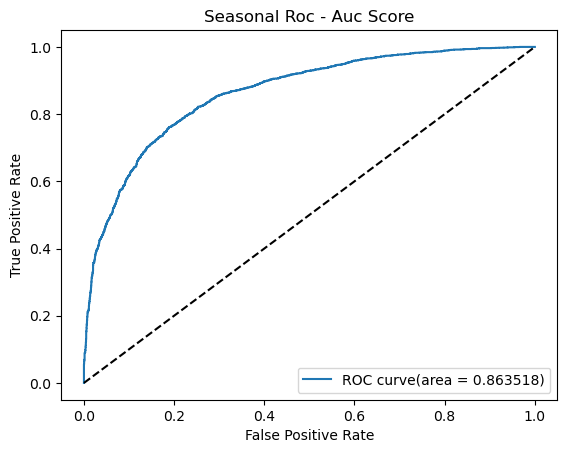

In [268]:
fpr, tpr, thresholds = roc_curve(y_test_seas, cat_model_roc_seas)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Seasonal Roc - Cat Boost')
plt.legend(loc="lower right")
plt.show()

<font size="5"> Predicting the model for Driven Data Submission </font> 

In [233]:
test = pd.read_csv('test_set_features.csv')

In [234]:
test.shape

(26708, 36)

In [235]:
for i, row in test[test['employment_occupation'].isna()].iterrows():
    conditions = (test["employment_status"]=="Unemployed")
    if conditions.any():
        test.loc[i, 'employment_occupation'] = 'unemployed_occupation'
        
for i, row in test[test['employment_occupation'].isna()].iterrows():
    conditions = (test["employment_status"]=="Not in Labor Force")
    if conditions.any():
        test.loc[i, 'employment_occupation'] = 'Not_in_laborforce'
        
for i, row in test[test['employment_occupation'].isna()].iterrows():
    conditions = (test["employment_status"]=="Employed")
    if conditions.any():
        test.loc[i, 'employment_occupation'] = 'other_occupation'
        
for i, row in test[test['employment_industry'].isna()].iterrows():
    conditions = (test["employment_status"]=="Unemployed")
    if conditions.any():
        test.loc[i, 'employment_industry'] = 'unemployed_in_industry'
        
for i, row in test[test['employment_industry'].isna()].iterrows():
    conditions = (test["employment_status"]=="Not in Labor Force")
    if conditions.any():
        test.loc[i, 'employment_industry'] = 'Not_in_laborforce'
        
for i, row in test[test['employment_industry'].isna()].iterrows():
    conditions = (test["employment_status"]=="Employed")
    if conditions.any():
        test.loc[i, 'employment_industry'] = 'other_industry'
        
income_poverty_nan = 'refused_or_unknown'
marital_status_nan = 'refused_or_other_category'
employment_status_nan = 'refused_or_other_category'
rent_or_own_nan = 'other_or_refused'
education_nan = 'refused_or_unknown'


test['income_poverty'].fillna(income_poverty_nan, inplace=True)
test['marital_status'].fillna(marital_status_nan, inplace=True)
test['employment_status'].fillna(employment_status_nan, inplace=True)
test['rent_or_own'].fillna(rent_or_own_nan, inplace=True)
test['education'].fillna(education_nan, inplace=True)

In [236]:
for features in ordinal_columns:
    test[features] = le.fit_transform(test[features])

In [237]:
test = pd.get_dummies(test, columns=category_columns, drop_first=True)

In [238]:
test.drop('respondent_id', axis=1, inplace=True)

In [239]:
h1n1_test_proba = h1n1_model_tuned.predict_proba(test)

In [240]:
seas_test_proba = seasonal_model_tuned.predict_proba(test)

In [241]:
h1n1_probability = h1n1_test_proba[:,1].reshape(-1,1)

In [242]:
seasonal_probability = seas_test_proba[:,1].reshape(-1,1)

In [243]:
h1n1_probability

array([[0.11101206],
       [0.03347328],
       [0.20636103],
       ...,
       [0.17713897],
       [0.03206827],
       [0.6214547 ]], dtype=float32)

In [244]:
seasonal_probability

array([[0.1995434 ],
       [0.03351166],
       [0.6610072 ],
       ...,
       [0.18738483],
       [0.29263285],
       [0.6720225 ]], dtype=float32)

In [271]:
submission = pd.read_csv('submission_format.csv')

In [272]:
submission.drop(['h1n1_vaccine','seasonal_vaccine'], axis=1, inplace=True)

In [273]:
submission['h1n1_vaccine'] = h1n1_probability

In [274]:
submission['seasonal_vaccine'] = seasonal_probability

In [275]:
submission.set_index("respondent_id",inplace=True)

In [276]:
submission.head()

,h1n1_vaccine,seasonal_vaccine
respondent_id,,
26707,0.111012,0.199543
26708,0.033473,0.033512
26709,0.206361,0.661007
26710,0.715332,0.882149
26711,0.308536,0.537591


In [ ]:
# Good to GO. 